# <span style="color:green"> Numerical Simulation Laboratory (NSL) </span>
## <span style="color:blue">  Numerical exercises 10</span>

### Exercise 10.1A

In questo esercizio viene chiesto di parallelizzare il codice di algoritmo genetico (GA) con librerie MPI (*Message Passing Interface*) per risolvere il problema del commesso viaggiatore (TSP) eseguendo $n$ ricerche GA parallele del percorso ottimale. Ogni nodo di calcolo deve eseguire una ricerca GA indipendente, chiamata "continente", e ogni $N_{migr}$ generazioni i continenti devono scambiarsi i loro individui migliori.

Il programma è stato eseguito nel modello SPMD (*Single Program Multiple Data*), ovvero tutti i processi utilizzano lo stesso eseguibile che lavora su insiemi di dati diversi. Ogni processo ha il suo *rank* univoco per essere distinto, che è nell'intervallo $[$0, *size*-1$]$ dove *size* è il numero di processi. È possibile far comportare i processi in modo diverso utilizzando il valore del *rank*.

Per parallelizzare il codice di algoritmo genetico, sono stati utilizzati i seguenti metodi della libreria MPI:
  - MPI_Init() -> per inizializzare MPI
  - MPI_Comm_size() -> per conoscere quanti processi sono attivi
  - MPI_Comm_rank() -> per conoscere il *rank* del processo
  - MPI_Send() -> per inviare l'individuo migliore
  - MPI_Recv() -> per ricevere l'individuo migliore
  - MPI_Reduce() -> per trovare il percorso più breve tra i processi con MPI_MIN e portare il risultato al processo *root* 
  - MPI_Finalize() -> per finalizzare MPI
  
E' stato modificato l'inizializzatore dei numeri casuali, in modo che in base al processo leggesse righe diverse dal file dei numeri primi e generasse così sequenze di numeri casuali differenti per ogni continente. E' stato anche aggiunto un metodo alla classe *Population* per aggiornare la popolazione con l'individuo ricevuto, che sostituisce il nuovo individuo con quello con la *loss function* peggiore. 

### Exercise 10.2

In questo esercizio viene chiesto di applicare il codice parallelo al problema del TSP per i 110 capoluoghi di provincia italiani con coordinate di longitudine e latitudine contenute nel file *cap_prov_ita.dat*.

Data la maggior complessità del problema rispetto all'esercitazione precedente, è stata aumentata la popolazione a 1000 individui e portato il numero di generazioni a 1000, mentre il parametro di selezione $p$, la probabilità di *crossover* $P_c$ e la probabilità di mutazione $P_m$, sono stati lasciati rispettivamente a $p=2$, $P_c=0.70$ e $P_m=0.10$. Il numero di generazioni tra le migrazioni è stato impostato a $N_{migr}=20$. Il programma è stato eseguito utilizzando 7 nodi.

In [1]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math
import imageio.v2 as imageio
import shutil
import os
from IPython.display import Image, display

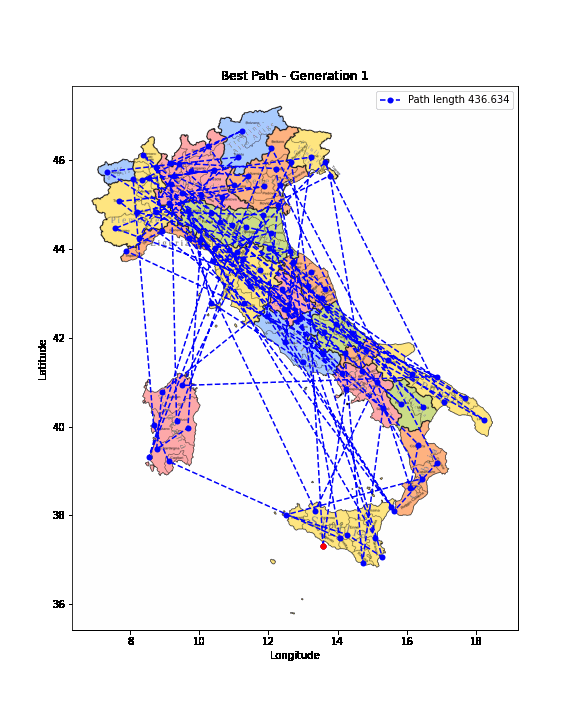

In [2]:
def read_path(filename):
    path = []
    with open(filename, 'r') as f:
        for line in f:
            x, y = map(float, line.strip().split(','))
            path.append((x, y))
    return path

def plot_path(path, generation, output_dir, bg_img_path, length):
    x, y = zip(*path)
    img = mpimg.imread(bg_img_path)
    plt.figure(figsize=(8,10))
    plt.imshow(img, extent=[min(x)-1, max(x)+1, min(y)-1.5, max(y)+1], aspect='auto')
    plt.plot(x, y, 'o', markersize=5, label=f'Path length {length}', color='blue', ls='--')
    plt.plot([x[0], x[-1]], [y[0], y[-1]], 'o', markersize=5, ls='--', color='red') # Connect start and end
    plt.title(f'Best Path - Generation {generation}')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.legend()
    plt.savefig(os.path.join(output_dir, f'gen_{generation}.png'))
    plt.close()

def create_gif(image_folder, output_gif):
    images = []
    for file_name in sorted(os.listdir(image_folder), key=lambda x: int(x.split('_')[1].split('.')[0])):
        if file_name.endswith('.png'):
            file_path = os.path.join(image_folder, file_name)
            images.append(imageio.imread(file_path))
    imageio.mimsave(output_gif, images, duration=0.5)

output_dir = 'images'
bg_img_path = 'italy.svg.png' 

if os.path.exists(output_dir):  # If directory exists, remove it
    shutil.rmtree(output_dir)
os.makedirs(output_dir) 

length = np.loadtxt('best_loss.txt')

for gen in range(1000):  # Update this range to match the number of generations
    filename = f'BEST_PATHS/best_path_gen_{gen+1}.txt'
    path = read_path(filename)
    plot_path(path, gen+1, output_dir, bg_img_path, length[gen])

create_gif(output_dir, 'best_paths.gif')
display(Image(filename='best_paths.gif'))

In [3]:
best_loss = np.loadtxt('best_loss.txt')
mean_loss = np.loadtxt('mean_loss.txt')

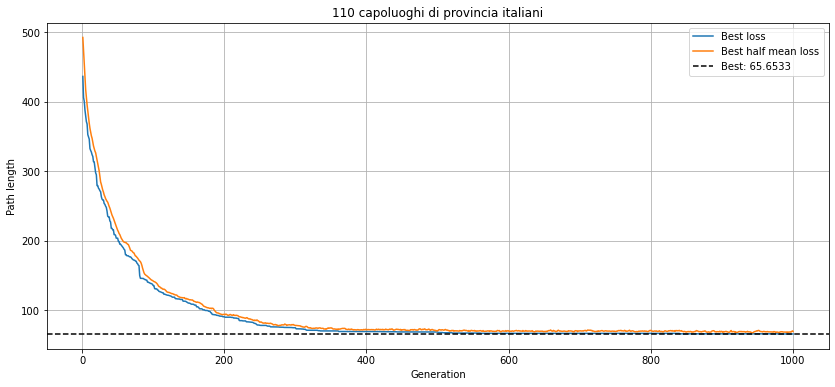

In [4]:
gen = np.arange(len(best_loss)) + 1
plt.figure(figsize=(14,6))
plt.plot(gen, best_loss, label='Best loss')
plt.plot(gen, mean_loss, label='Best half mean loss')
plt.axhline(best_loss[999], color = "k", linestyle = "--", label = "Best: " + str(best_loss[999]))
plt.title('110 capoluoghi di provincia italiani') 
plt.xlabel('Generation')
plt.ylabel('Path length')
plt.legend()
plt.grid()
plt.show()

Notiamo che la media $\langle L^{(2)}\rangle$ sulla metà migliore della popolazione è simile alla $L^{(2)}$ del percorso più breve. Questo può essere causato dalle migrazioni tra i continenti che tolgono diversità alla popolazione.

In [5]:
x, y = np.loadtxt('final_best_path.txt', delimiter=',', usecols=(0,1), unpack=True)
X, Y = np.loadtxt('final_best_path_migr.txt', delimiter=',', usecols=(0,1), unpack=True)
length = np.loadtxt('global_best_loss.txt')
length_migr = np.loadtxt('global_best_loss_migr.txt')

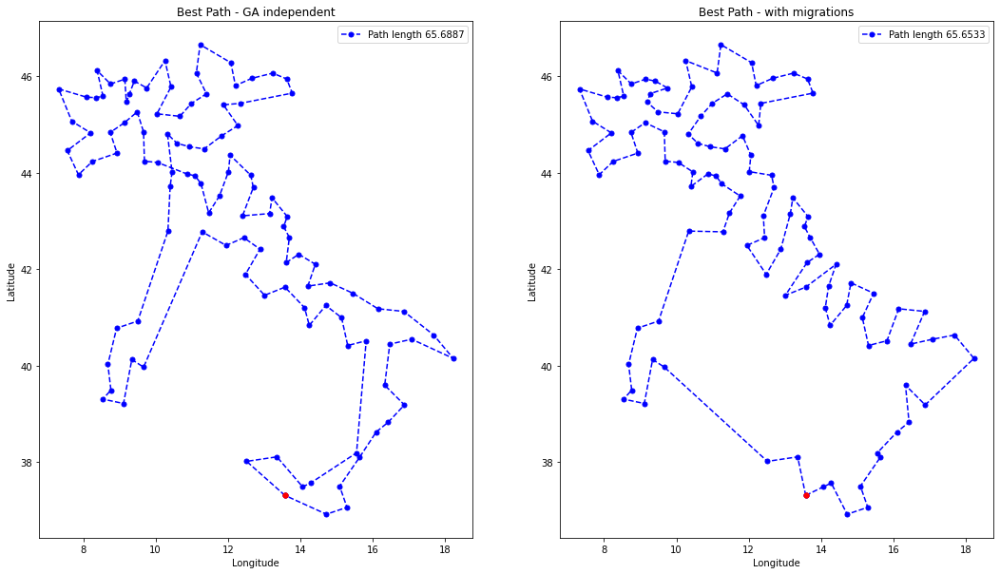

In [6]:
bg_img_path = 'italy.svg.png'
img = mpimg.imread(bg_img_path)

fig, [ax0, ax1] = plt.subplots(1, 2, figsize=(18,10))
#ax0.imshow(img, extent=[min(x)-1, max(x)+1, min(y)-1.5, max(y)+1], aspect='auto')
ax0.plot(x, y, 'o', markersize=5, label=f'Path length {length}', color='blue', ls='--')
ax0.plot([x[0], x[-1]], [y[0], y[-1]], 'o', markersize=5, ls='--', color='red') # Connect start and end
ax0.set_title(f'Best Path - GA independent')
ax0.set_xlabel('Longitude')
ax0.set_ylabel('Latitude')
ax0.legend()

#ax1.imshow(img, extent=[min(X)-1, max(X)+1, min(Y)-1.5, max(Y)+1], aspect='auto')
ax1.plot(X, Y, 'o', markersize=5, label=f'Path length {length_migr}', color='blue', ls='--')
ax1.plot([X[0], X[-1]], [Y[0], Y[-1]], 'o', markersize=5, ls='--', color='red') # Connect start and end
ax1.set_title(f'Best Path - with migrations')
ax1.set_xlabel('Longitude')
ax1.set_ylabel('Latitude')
ax1.legend()
plt.show()

Da questi grafici possiamo osservare che utilizzando lo stesso numero di nodi, ma eseguendo ricerche GA indipendenti (senza migrazioni), si ottiene un risultato leggermente peggiore. 